# NLP Project- 2024W AML 2304 Natural Language Processing 
<hr>

**Used the data are stock tweets and stock prices.**

## 1. Importing Libraries and Dataset

In [3]:
import numpy as np
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import ta
from ta.trend import MACD
from plotly.subplots import make_subplots



# Natural Language Processing Libraries
import string
import re
import spacy
import nltk
nltk.download('stopwords')
from nltk.sentiment.vader import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')

#Scikit Learn
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import LabelEncoder
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, cross_val_predict, KFold
from imblearn import over_sampling
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.naive_bayes import MultinomialNB


# Tensorflow Library
import tensorflow as tf
from tensorflow.keras import layers, models

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/shreyanair/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/shreyanair/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
2024-04-05 22:28:59.035771: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


## 2. Data Exploration

In [4]:
df1 = pd.read_csv("stock_tweets.csv")

In [5]:
df1.head()

,Date,Tweet,Stock Name,Company Name
0,2022-09-29 23:41:16+00:00,Mainstream media has done an amazing job at br...,TSLA,"Tesla, Inc."
1,2022-09-29 23:24:43+00:00,Tesla delivery estimates are at around 364k fr...,TSLA,"Tesla, Inc."
2,2022-09-29 23:18:08+00:00,3/ Even if I include 63.0M unvested RSUs as of...,TSLA,"Tesla, Inc."
3,2022-09-29 22:40:07+00:00,@RealDanODowd @WholeMarsBlog @Tesla Hahaha why...,TSLA,"Tesla, Inc."
4,2022-09-29 22:27:05+00:00,"@RealDanODowd @Tesla Stop trying to kill kids,...",TSLA,"Tesla, Inc."


In [6]:
df1.columns

Index(['Date', 'Tweet', 'Stock Name', 'Company Name'], dtype='object')

### 2.1 Knowing More About Data

In [7]:
df1.duplicated().sum()

0

In [8]:
df1.isnull().sum()

Date            0
Tweet           0
Stock Name      0
Company Name    0
dtype: int64

There are no null values.

In [9]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 80793 entries, 0 to 80792
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Date          80793 non-null  object
 1   Tweet         80793 non-null  object
 2   Stock Name    80793 non-null  object
 3   Company Name  80793 non-null  object
dtypes: object(4)
memory usage: 2.5+ MB


In [10]:
df1.nunique()

Date            64424
Tweet           64479
Stock Name         25
Company Name       25
dtype: int64

In [11]:
df1["Stock Name"].unique()

array(['TSLA', 'MSFT', 'PG', 'META', 'AMZN', 'GOOG', 'AMD', 'AAPL',
       'NFLX', 'TSM', 'KO', 'F', 'COST', 'DIS', 'VZ', 'CRM', 'INTC', 'BA',
       'BX', 'NOC', 'PYPL', 'ENPH', 'NIO', 'ZS', 'XPEV'], dtype=object)

In [12]:
df1["Stock Name"].value_counts()

Stock Name
TSLA    37422
TSM     11034
AAPL     5056
PG       4089
AMZN     4089
MSFT     4089
NIO      3021
META     2751
AMD      2227
NFLX     1727
GOOG     1291
PYPL      843
DIS       635
BA        399
COST      393
INTC      315
KO        310
CRM       233
XPEV      225
ENPH      216
ZS        193
VZ        123
BX         50
NOC        31
F          31
Name: count, dtype: int64

In [13]:
df1["Company Name"].value_counts()

Company Name
Tesla, Inc.                                           37422
Taiwan Semiconductor Manufacturing Company Limited    11034
Apple Inc.                                             5056
Procter & Gamble Company                               4089
Amazon.com, Inc.                                       4089
Microsoft Corporation                                  4089
NIO Inc.                                               3021
Meta Platforms, Inc.                                   2751
Advanced Micro Devices, Inc.                           2227
Netflix, Inc.                                          1727
Alphabet Inc.                                          1291
PayPal Holdings, Inc.                                   843
The Walt Disney Company                                 635
The Boeing Company                                      399
Costco Wholesale Corporation                            393
Intel Corporation                                       315
The Coca-Cola Company      

### 2.2 Initial Visualizations

In [14]:
# Create a Plotly figure
fig = px.bar(df1['Stock Name'].value_counts(), 
             x=df1['Stock Name'].value_counts().index, 
             y=df1['Stock Name'].value_counts().values, 
             labels={'x': 'Stock Name', 'y': 'Count'},
             title='Countplot of Stock Names')

# Show the figure
fig.show()


In [15]:
fig = px.pie(df1, names='Company Name', title='Stock Name Distribution')
fig.update_layout(
    title='Stock Name Distribution',
    height=800,  
    width=1000    
)
fig.show()

<div class="alert alert-block alert-note">
<b>NOTE:</b> 
Based on the pie chart showing the distribution of tweets among different companies, several insights can be derived:

- **Dominance of Tesla Inc. (46.3%):** Tesla Inc. receives the highest proportion of tweets among all companies, indicating a significant level of public interest and attention towards Tesla's activities, products, and announcements. This suggests that Tesla is a highly discussed and influential company within the context of the stock market on social media platforms.

- **Taiwan Semiconductor Manufacturing Company Limited (14.6%):** Taiwan Semiconductor Manufacturing Company Limited is the second most talked-about company in the dataset. This could indicate a focus on semiconductor industry trends, given the company's significance in the global semiconductor manufacturing landscape.

- **Apple Inc. (6.26%):** Apple Inc. receives a notable proportion of tweets, reflecting the enduring popularity and market presence of the tech giant. Discussion around Apple may include product launches, financial performance, and industry developments.

- **Procter & Gamble Company, Amazon.com, and Microsoft Corporation (5.06% each):** These three companies receive a similar share of tweets, suggesting a balanced level of attention across different sectors. Procter & Gamble represents the consumer goods sector, Amazon.com is a major player in e-commerce and technology, and Microsoft Corporation is a leading software and cloud services provider. The consistent level of discussion around these companies may indicate ongoing market interest and activity in their respective industries.

- **Other Companies:** The remaining 20 companies collectively represent 22.76% of the tweets. While they may not individually receive as much attention as the top companies, their presence highlights a diverse range of stocks being discussed in the dataset. Further analysis could explore the specific trends and factors driving discussions around these companies.
</div>

In [16]:
df1['Date'] = pd.to_datetime(df1['Date'])

In [17]:
df1_copy = df1.copy()
df1_copy

,Date,Tweet,Stock Name,Company Name
0,2022-09-29 23:41:16+00:00,Mainstream media has done an amazing job at br...,TSLA,"Tesla, Inc."
1,2022-09-29 23:24:43+00:00,Tesla delivery estimates are at around 364k fr...,TSLA,"Tesla, Inc."
2,2022-09-29 23:18:08+00:00,3/ Even if I include 63.0M unvested RSUs as of...,TSLA,"Tesla, Inc."
3,2022-09-29 22:40:07+00:00,@RealDanODowd @WholeMarsBlog @Tesla Hahaha why...,TSLA,"Tesla, Inc."
4,2022-09-29 22:27:05+00:00,"@RealDanODowd @Tesla Stop trying to kill kids,...",TSLA,"Tesla, Inc."
...,...,...,...,...
80788,2021-10-07 17:11:57+00:00,Some of the fastest growing tech stocks on the...,XPEV,XPeng Inc.
80789,2021-10-04 17:05:59+00:00,"With earnings on the horizon, here is a quick ...",XPEV,XPeng Inc.
80790,2021-10-01 04:43:41+00:00,Our record delivery results are a testimony of...,XPEV,XPeng Inc.
80791,2021-10-01 00:03:32+00:00,"We delivered 10,412 Smart EVs in Sep 2021, rea...",XPEV,XPeng Inc.


The timestamp format "2022-09-29 23:41:16+00:00" adheres to the ISO 8601 standard for date and time representation, including a time zone offset. Here's a breakdown of its components:

1. "2022": Denotes the year.
2. "09": Represents the month, specifically September.
3. "29": Indicates the day of the month.
4. "23": Specifies the hour in 24-hour format, which in this case, corresponds to 11:00 PM.
5. "41": Represents the minute.
6. "16": Indicates the second.
7. "+00:00": This segment denotes the time zone offset. In this instance, it signifies Coordinated Universal Time (UTC), with no deviation from UTC. Therefore, the provided timestamp corresponds to September 29, 2022, at 11:41:16 PM (23:41:16) in the UTC time zone.






In [18]:
df1_copy.set_index('Date', inplace=True)

In [19]:
start_date = df1_copy.index.min()
end_date = df1_copy.index.max()

In [20]:
print("Start Date of Stocks:", start_date)
print("End Date of Stocks:", end_date)

Start Date of Stocks: 2021-09-30 00:06:02+00:00
End Date of Stocks: 2022-09-29 23:41:16+00:00


In [21]:
week_delta = pd.Timedelta(days=7)
current_date = start_date

### 2.3. Analysis of the stocks on weekly & Daily basis

In [22]:
def visualize_weekly_tweets(df):
    # Define timedelta object representing a week
    week_delta = pd.Timedelta(days=7)

    # Find start and end dates
    start_date = df.index.min()
    end_date = df.index.max()

    # Initialize current date
    current_date = start_date

    # Iterate through each week
    while current_date <= end_date:
        # Define start and end dates for the current week
        start_week = current_date
        end_week = current_date + week_delta

        # Filter data for the current week
        current_week_data = df[(df.index >= start_week) & (df.index < end_week)]

        # Resample data to get daily tweet counts
        weekly_counts = current_week_data.resample('D').size()

        # Create a bar plot using Plotly Express
        fig = px.bar(weekly_counts, x=weekly_counts.index, y=weekly_counts.values,
                     labels={'x': 'Date', 'y': 'Number of Tweets'},
                     title=f'Tweets for Week {start_week.strftime("%Y-%m-%d")} to {end_week.strftime("%Y-%m-%d")}')
        fig.update_layout(xaxis_tickangle=-45)
        fig.show()

        # Move to the next week
        current_date += week_delta


In [23]:
visualize_weekly_tweets(df1_copy)

The `visualize_weekly_tweets` function takes a DataFrame containing tweet data with a datetime index as input. It iterates through each week within the dataset, filtering the tweet data for each week and computing the count of tweets per day using resampling. Subsequently, it generates a bar plot using Plotly Express to visualize the daily tweet counts for each week, with the x-axis representing dates and the y-axis representing the number of tweets. The function then moves on to the next week until it has covered the entire duration of the dataset, providing an overview of weekly tweet activity over time.

In [24]:
daily_counts = df1_copy.resample('D').size()
fig = go.Figure()
fig.add_trace(go.Bar(x=daily_counts.index, y=daily_counts.values,
                     marker_color='skyblue'))
fig.update_layout(title='Number of Tweets Day-wise',
                  xaxis_title='Date',
                  yaxis_title='Number of Tweets',
                  xaxis_tickangle=-45)
fig.show()

<div class="alert alert-block alert-note">
<b>NOTE:</b> 
The above function generates a bar plot using Plotly's `go.Figure()` module to visualize the daily tweet activity. It first resamples the data to aggregate it on a daily basis, counting the number of tweets for each day. Then, it creates a bar plot where the x-axis represents the dates, the y-axis represents the corresponding number of tweets. </div>

## 3. Natural Language Processing

### 3.1. Text Cleaning

#### 3.1.1. Removing the whitespace and converting into lower case

In [25]:
def clean_text(text):
    text = text.lower()
    return text.strip()

In [26]:
df1.Tweet = df1.Tweet.apply(lambda x: clean_text(x))

#### 3.1.2. Removing the punctuations

In [27]:
string.punctuation
def remove_punctuation(text):
    punctuationfree="".join([i for i in text if i not in string.punctuation])
    return punctuationfree

In [28]:
df1.Tweet = df1.Tweet.apply(lambda x:remove_punctuation(x))

#### 3.1.3. Tokenization

In [29]:
def tokenization(text):
    tokens = re.split('W+',text)
    return tokens

In [30]:
df1.Tweet = df1.Tweet.apply(lambda x: tokenization(x))

#### 3.1.4. Removing Stop Words

In [31]:
stopwords = nltk.corpus.stopwords.words('english')
stopwords[0:10]
['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're"]

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're"]

In [32]:
def remove_stopwords(text):
    output= " ".join(i for i in text if i not in stopwords)
    return output

In [33]:
df1.Tweet = df1.Tweet.apply(lambda x:remove_stopwords(x))

#### 3.1.5. Applying the function to get the cleaned text

In [34]:
def clean_text(text):
    text = re.sub('\[.*\]','', text).strip() 
    text = re.sub('\S*\d\S*\s*','', text).strip()  
    return text.strip()

In [35]:
df1.Tweet = df1.Tweet.apply(lambda x: clean_text(x))

This function is useful for removing specific patterns, such as text enclosed in square brackets and sequences of characters containing digits, from a given text, leaving behind a cleaner version of the text.

### 3.2. Using Spacy to complete the Data Cleaning

In [36]:
nlp = spacy.load('en_core_web_sm')

nlp = spacy.load('en_core_web_sm'): This line loads a specific spaCy model named 'en_core_web_sm'. Here's what it does:

SpaCy provides various pre-trained language models for different languages and use cases. 'en_core_web_sm' is one of the pre-trained models for the English language, specifically optimized for small to medium-sized text processing tasks.

spacy.load('en_core_web_sm') loads the English language model and initializes it as the nlp object. This object can then be used to process and analyze text in various ways, such as tokenization, part-of-speech tagging, named entity recognition, and more.

#### 3.2.1 Lemmatization using Spacy

In [37]:
stopwords = nlp.Defaults.stop_words
def lemmatizer(text):
    doc = nlp(text)
    sent = [token.lemma_ for token in doc if not token.text in set(stopwords)]
    return ' '.join(sent)

In [38]:
df1.Tweet =  df1.Tweet.apply(lambda x: lemmatizer(x))

#### 3.2.2. Removing URLs

In [39]:
def remove_urls(vTEXT):
    vTEXT = re.sub(r'(https|http)?:\/\/(\w|\.|\/|\?|\=|\&|\%)*\b', '', vTEXT, flags=re.MULTILINE)
    return(vTEXT)

In [40]:
df1.Tweet = df1.Tweet.apply(lambda x: remove_urls(x))

#### 3.2.3. Removing Digits

In [41]:
def remove_digits(text):
    clean_text = re.sub(r"\b[0-9]+\b\s*", "", text)
    return(text)

In [42]:
df1.Tweet = df1.Tweet.apply(lambda x: remove_digits(x))

#### 3.2.4. Removing Emojis

In [43]:
def remove_emojis(data):
    emoji_pattern = re.compile("["
                               u"\U0001F600-\U0001F64F" 
                               u"\U0001F300-\U0001F5FF"  
                               u"\U0001F680-\U0001F6FF"  
                               u"\U0001F1E0-\U0001F1FF"  
                               "]+", flags=re.UNICODE)
    return re.sub(emoji_pattern, '', data)

In [44]:
df1.Tweet = df1.Tweet.apply(lambda x: remove_emojis(x))

<div class="alert alert-block alert-info">
<b>NOTE:</b>The `remove_emojis` function takes a string `data` as input and removes any emojis present in the string. It achieves this by utilizing a regular expression (`emoji_pattern`) to match and replace any Unicode characters representing emojis. The regular expression pattern encompasses various Unicode ranges corresponding to emojis, including smileys, symbols, transportation, flags, and regional indicators. The function then returns the input string with emojis removed using the `re.sub()` method from the `re` module.</div>

In [45]:
df1

,Date,Tweet,Stock Name,Company Name
0,2022-09-29 23:41:16+00:00,mainstream medium amazing job brainwash people...,TSLA,"Tesla, Inc."
1,2022-09-29 23:24:43+00:00,tesla delivery estimate analyst tsla,TSLA,"Tesla, Inc."
2,2022-09-29 23:18:08+00:00,include unvested rsus additional equity need r...,TSLA,"Tesla, Inc."
3,2022-09-29 22:40:07+00:00,realdanodowd wholemarsblog tesla hahaha try st...,TSLA,"Tesla, Inc."
4,2022-09-29 22:27:05+00:00,realdanodowd tesla stop try kill kid sad deran...,TSLA,"Tesla, Inc."
...,...,...,...,...
80788,2021-10-07 17:11:57+00:00,fast grow tech stock market mix fintech adtech...,XPEV,XPeng Inc.
80789,2021-10-04 17:05:59+00:00,earning horizon quick snapshot large increase ...,XPEV,XPeng Inc.
80790,2021-10-01 04:43:41+00:00,record delivery result testimony unwavering pu...,XPEV,XPeng Inc.
80791,2021-10-01 00:03:32+00:00,deliver smart evs sep reach milestone monthly ...,XPEV,XPeng Inc.


### 3.3. WordCloud Visualization

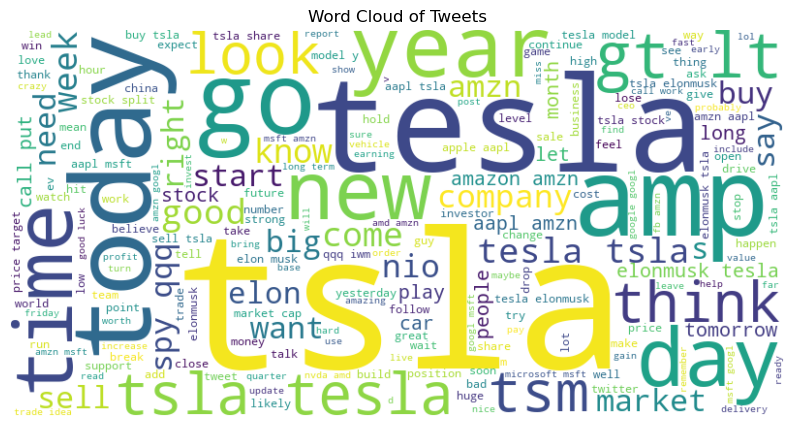

In [46]:
all_tweets = ' '.join(df1['Tweet'])
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_tweets)
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud of Tweets')
plt.axis('off')
plt.show()


## 4. Sentiment Analysis

The `SentimentIntensityAnalyzer` is a feature provided by the Natural Language Toolkit (NLTK) library, particularly found in the nltk.sentiment.vader module. It serves as a tool for conducting sentiment analysis on text data. Sentiment analysis involves the identification of the sentiment or emotional tone conveyed in a piece of text, discerning whether it's positive, negative, or neutral. 

Prior to utilizing the `SentimentIntensityAnalyzer`, it's essential to download the VADER (Valence Aware Dictionary and sEntiment Reasoner) lexicon. VADER comprises a predefined lexicon of words along with their associated sentiment scores. This lexicon encompasses thousands of words, each assigned a polarity score indicating its positivity, negativity, or neutrality. The download of the VADER lexicon is a prerequisite for leveraging the `SentimentIntensityAnalyzer`, as the analyzer relies on this lexicon to evaluate sentiment.

In [47]:
def get_sentiment_label(text):
    sia = SentimentIntensityAnalyzer()
    sentiment_scores = sia.polarity_scores(text)
    
    if sentiment_scores['compound'] >= 0.05:
        return 'Positive'
    elif sentiment_scores['compound'] <= -0.05:
        return 'Negative'
    else:
        return 'Neutral'

In [48]:
df1['Sentiment_Scores'] = df1['Tweet'].apply(lambda x: SentimentIntensityAnalyzer().polarity_scores(x))

In [49]:
df1['sentiment'] = df1['Tweet'].apply(get_sentiment_label)

In [50]:
df1

,Date,Tweet,Stock Name,Company Name,Sentiment_Scores,sentiment
0,2022-09-29 23:41:16+00:00,mainstream medium amazing job brainwash people...,TSLA,"Tesla, Inc.","{'neg': 0.153, 'neu': 0.642, 'pos': 0.205, 'co...",Positive
1,2022-09-29 23:24:43+00:00,tesla delivery estimate analyst tsla,TSLA,"Tesla, Inc.","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",Neutral
2,2022-09-29 23:18:08+00:00,include unvested rsus additional equity need r...,TSLA,"Tesla, Inc.","{'neg': 0.0, 'neu': 0.896, 'pos': 0.104, 'comp...",Positive
3,2022-09-29 22:40:07+00:00,realdanodowd wholemarsblog tesla hahaha try st...,TSLA,"Tesla, Inc.","{'neg': 0.386, 'neu': 0.436, 'pos': 0.178, 'co...",Negative
4,2022-09-29 22:27:05+00:00,realdanodowd tesla stop try kill kid sad deran...,TSLA,"Tesla, Inc.","{'neg': 0.588, 'neu': 0.412, 'pos': 0.0, 'comp...",Negative
...,...,...,...,...,...,...
80788,2021-10-07 17:11:57+00:00,fast grow tech stock market mix fintech adtech...,XPEV,XPeng Inc.,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",Neutral
80789,2021-10-04 17:05:59+00:00,earning horizon quick snapshot large increase ...,XPEV,XPeng Inc.,"{'neg': 0.0, 'neu': 0.803, 'pos': 0.197, 'comp...",Positive
80790,2021-10-01 04:43:41+00:00,record delivery result testimony unwavering pu...,XPEV,XPeng Inc.,"{'neg': 0.0, 'neu': 0.851, 'pos': 0.149, 'comp...",Positive
80791,2021-10-01 00:03:32+00:00,deliver smart evs sep reach milestone monthly ...,XPEV,XPeng Inc.,"{'neg': 0.0, 'neu': 0.84, 'pos': 0.16, 'compou...",Positive


In [51]:
df1.rename(columns={'sentiment': 'Sentiment'}, inplace=True)

In [52]:
df1.to_csv('stock_tweets_sentiments_new.csv', index=False)

In [53]:
df1['Sentiment'].unique()

array(['Positive', 'Neutral', 'Negative'], dtype=object)

In [54]:
df1["Sentiment"].value_counts()

Sentiment
Positive    41101
Neutral     24060
Negative    15632
Name: count, dtype: int64

In [55]:

fig = px.histogram(df1, x='Sentiment', title='Countplot of Sentiment', color='Sentiment')
fig.update_layout(xaxis={'categoryorder':'total descending'})
fig.show()


<div class="alert alert-block alert-warning">
<b>INSIGHTS:</b>The count of positive sentiments is the highest, with approximately 41,101 occurrences, indicating a prevalent positivity in the analyzed texts. Following positive sentiments, neutral sentiments are the next most frequent, with around 24,060 occurrences, suggesting a substantial presence of neutral expressions in the dataset. Finally, negative sentiments are the least common, with approximately 15,632 occurrences, indicating a lower frequency of negative expressions compared to positive and neutral ones. Overall, these insights suggest a predominantly positive sentiment within the dataset, followed by neutral expressions and a relatively lower occurrence of negative sentiments. This information could be valuable for understanding the overall sentiment distribution and potentially informing decision-making processes related to sentiment analysis tasks.</div>

In [56]:
sentiment_counts = df1['Sentiment'].value_counts()
fig = go.Figure(data=[go.Pie(labels=sentiment_counts.index, values=sentiment_counts.values, 
                             hole=0.3, marker_colors=px.colors.qualitative.Pastel)])
fig.update_layout(title='Pie Chart of Sentiment', width=800, height=800)
fig.show()


#### 4.1. WordCloud after Sentimental Analysis 

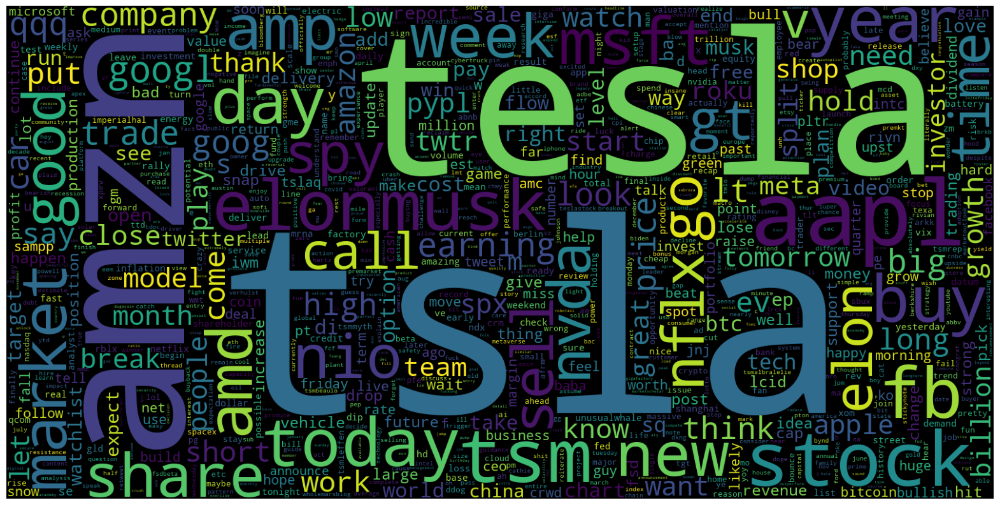

In [57]:
data = df1.Tweet
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
# This parameter disables the combination of words (collocations) in the word cloud. Collocations are pairs of words that often appear together in the text.
plt.imshow(wc)
plt.axis('off')
plt.show()

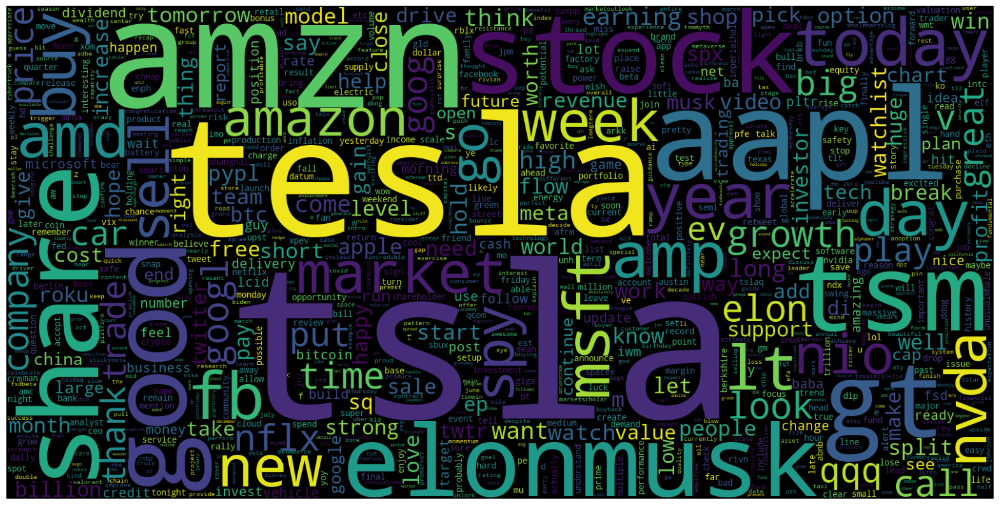

In [58]:
data = df1[df1['Sentiment'] == "Positive"]['Tweet']
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

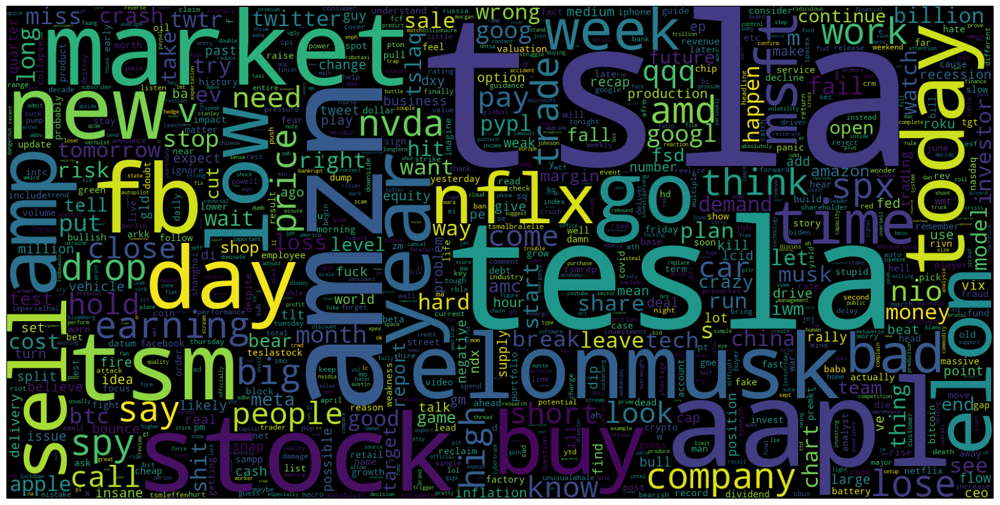

In [59]:
data = df1[df1['Sentiment'] == "Negative"]['Tweet']
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

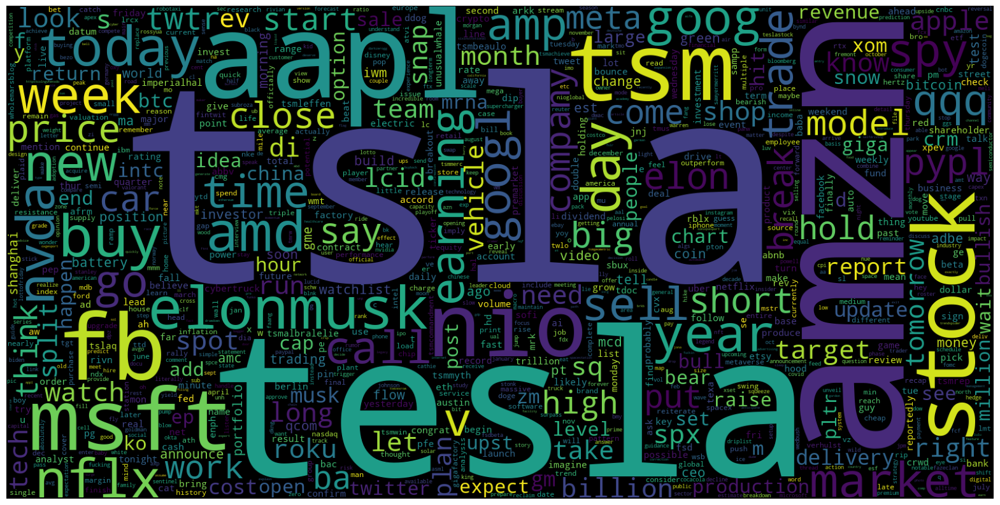

In [60]:
data = df1[df1['Sentiment'] == "Neutral"]['Tweet']
plt.figure(figsize = (20,20))
wc = WordCloud(max_words = 1000 , width = 1600 , height = 800,
               collocations=False).generate(" ".join(data))
plt.imshow(wc)
plt.axis('off')
plt.show()

<div class="alert alert-block alert-important">
<b>PLEASE NOTE: </b><div>This shows that the most repetative words in each sentiment, we can't get a whole picture from this wordcloud. We will be doing the wordcloud for each stock in the future.</div>

In [61]:
sentiment_counts_stock = df1.groupby(['Stock Name', 'Sentiment']).size().unstack(fill_value=0)

In [62]:
sentiment_counts_stock

Sentiment,Negative,Neutral,Positive
Stock Name,,,
AAPL,1032,1701,2323
AMD,299,586,1342
AMZN,796,1024,2269
BA,54,139,206
BX,5,12,33
COST,74,139,180
CRM,31,88,114
DIS,107,232,296
ENPH,29,52,135


In [63]:
sentiment_counts_company = df1.groupby(['Company Name', 'Sentiment']).size().unstack(fill_value=0)

In [64]:
sentiment_counts_company

Sentiment,Negative,Neutral,Positive
Company Name,,,
"Advanced Micro Devices, Inc.",299,586,1342
Alphabet Inc.,213,411,667
"Amazon.com, Inc.",796,1024,2269
Apple Inc.,1032,1701,2323
Blackstone Inc.,5,12,33
Costco Wholesale Corporation,74,139,180
"Enphase Energy, Inc.",29,52,135
Ford Motor Company,9,5,17
Intel Corporation,58,99,158


<div class="alert alert-block alert-notes">
<b>INSIGHTS:</b>The above table shows the sentiment analysis results for various company stocks, with sentiments categorized as negative, neutral, and positive. 

1. Firstly, there is significant variation in sentiment distribution across different companies. For instance, some companies like Tesla, Inc. exhibit a substantial number of positive sentiments (18,701), far outnumbering negative (7,696) and neutral (11,025) sentiments, suggesting a highly positive perception of the company. 

2. In contrast, companies like Blackstone Inc. have relatively low sentiment counts across all categories, indicating a less pronounced sentiment profile. 

3. Moreover, certain companies show a balanced distribution of sentiments, with comparable counts across negative, neutral, and positive categories, such as Microsoft Corporation and Procter & Gamble Company, reflecting a mixed sentiment landscape. Overall, analyzing sentiment distribution can provide valuable insights into public perception, brand sentiment, and potentially guide strategic decision-making processes for these companies.</div>

In [65]:
def analyze_sentiment_counts(sentiment_counts_company):
    sentiment_counts_company['Total_Positive'] = sentiment_counts_company['Positive']
    sentiment_counts_company['Total_Negative'] = sentiment_counts_company['Negative']
    sentiment_counts_company['Total_Neutral'] = sentiment_counts_company['Neutral']

    # Define lists to store company names and corresponding sentiment types
    companies = ['Positive', 'Negative', 'Neutral']
    sentiments = ['Highest', 'Lowest']

    # Loop through each sentiment type and company
    for sentiment in sentiments:
        for company in companies:
            # Calculate the company with the highest or lowest sentiment count and its value
            if sentiment == 'Highest':
                company_name = sentiment_counts_company[f'Total_{company}'].idxmax()
                sentiment_count = sentiment_counts_company[f'Total_{company}'].max()
            else:
                company_name = sentiment_counts_company[f'Total_{company}'].idxmin()
                sentiment_count = sentiment_counts_company[f'Total_{company}'].min()
            
            # Print the result
            print(f"Company with {sentiment} {company} Sentiment Count: {company_name} ({sentiment_count} {company.lower()} sentiments)")



In [66]:
analyze_sentiment_counts(sentiment_counts_company)

Company with Highest Positive Sentiment Count: Tesla, Inc. (18701 positive sentiments)
Company with Highest Negative Sentiment Count: Tesla, Inc. (7696 negative sentiments)
Company with Highest Neutral Sentiment Count: Tesla, Inc. (11025 neutral sentiments)
Company with Lowest Positive Sentiment Count: Ford Motor Company (17 positive sentiments)
Company with Lowest Negative Sentiment Count: Blackstone Inc. (5 negative sentiments)
Company with Lowest Neutral Sentiment Count: Ford Motor Company (5 neutral sentiments)


#### 4.2. WordCloud for each Company Stocks based on the sentimence

In [67]:
def plot_wordclouds(df, sentiment):
    # Filter the DataFrame based on the sentiment
    sentiment_data = df[df['Sentiment'] == sentiment]

    # Group the filtered data by 'Stock Name'
    grouped_data = sentiment_data.groupby('Stock Name')

    # Determine the number of plots needed and define subplot layout
    num_plots = min(len(grouped_data), 25)  
    rows, cols = (num_plots // 5) + 1, min(num_plots, 5)  

    # Create a figure with specified size
    plt.figure(figsize=(20, 20))

    # Iterate over grouped data and generate WordClouds for each stock
    for i, (stock_name, data) in enumerate(grouped_data):
        wc = WordCloud(max_words=1000, width=1600, height=800, collocations=False).generate(" ".join(data['Tweet']))
        plt.subplot(rows, cols, i + 1)
        plt.imshow(wc, interpolation='bilinear')
        plt.title(stock_name)
        plt.axis('off')

    # Show the plot
    plt.show()


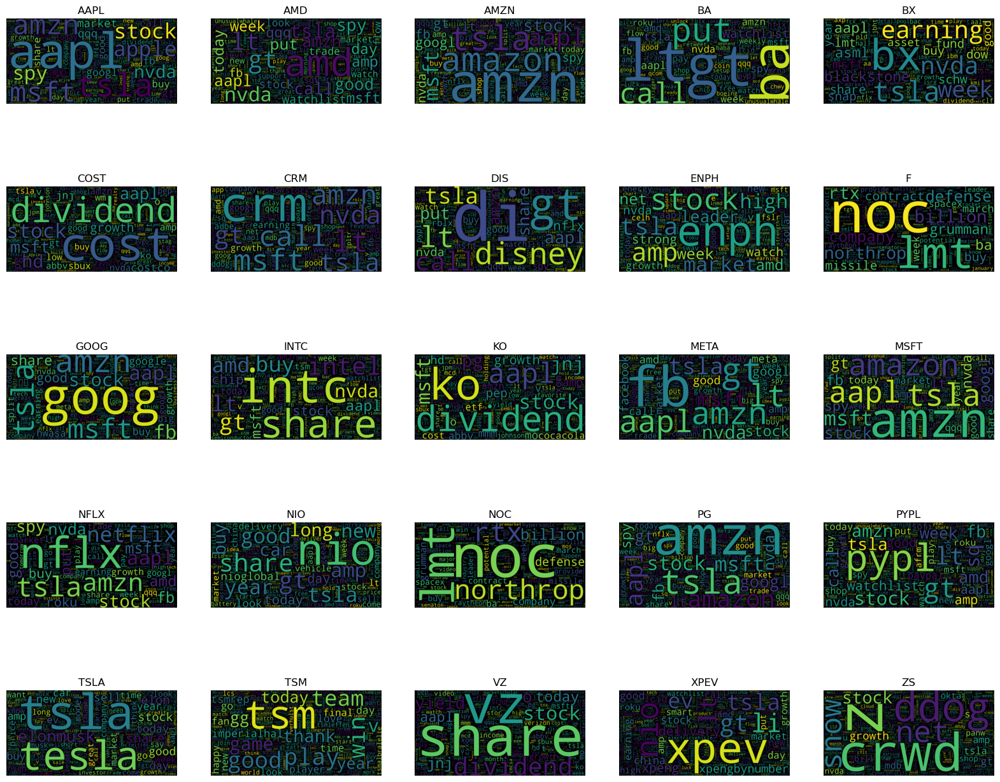

In [68]:
plot_wordclouds(df1, 'Positive')

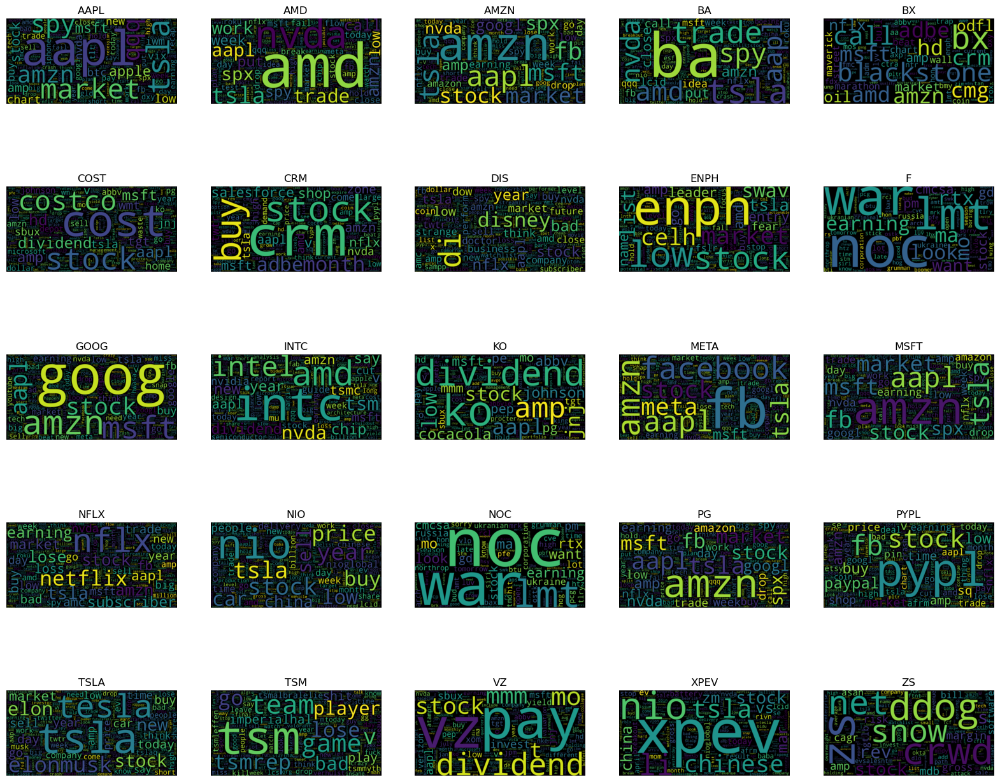

In [69]:
plot_wordclouds(df1, 'Negative')

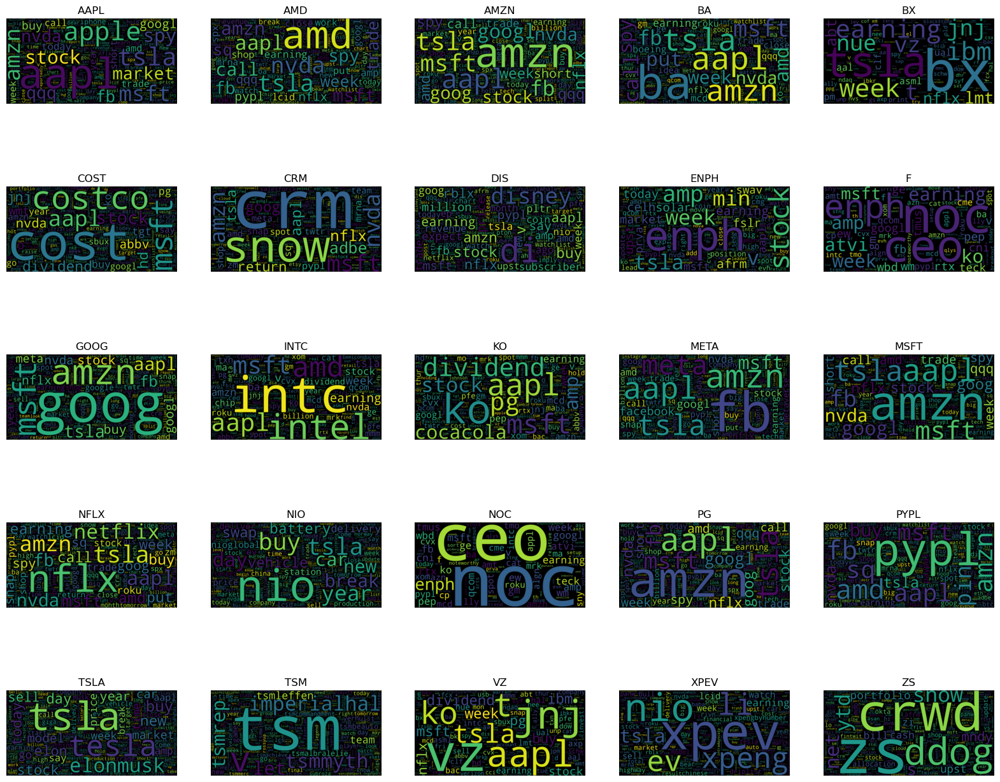

In [70]:
plot_wordclouds(df1, 'Neutral')

## 5. TFIDF Vectorizer

- TfidfVectorizer stands for "Term Frequency-Inverse Document Frequency Vectorizer." It's a feature extraction technique commonly used in natural language processing and information retrieval. Here's a brief explanation:

- Term Frequency (TF): It measures how frequently a term (word) appears in a document. In other words, it calculates the number of times a word occurs in a text.

- Inverse Document Frequency (IDF): It measures the importance of a term in a collection of documents (corpus). Words that appear in many documents have a lower IDF, while words that appear in only a few documents have a higher IDF. The purpose of IDF is to give more weight to terms that are relatively rare because they may carry more meaningful information.

- TF-IDF: This is the product of TF and IDF. It combines information about the frequency of a term in a specific document with its rarity across the entire corpus. TF-IDF assigns a higher value to terms that are both frequent in a document and unique to that document.

- TfidfVectorizer is used to convert a collection of raw text documents into a matrix of TF-IDF features. It takes care of preprocessing the text (e.g., tokenization, lowercasing, removing stop words) and computes the TF-IDF values for each term in each document. The result is a matrix where each row represents a document, and each column represents a unique term in the corpus.

In natural language processing and machine learning, this TF-IDF matrix is often used as input for various text classification and clustering algorithms. It helps in representing text data in a format that can be processed by machine learning models.


In [71]:
tf1=TfidfVectorizer()
data_vec=tf1.fit_transform(df1['Tweet'])

## 6. Encoding

In [72]:
label_encoder = LabelEncoder()
df1['Sentiment_Label'] = label_encoder.fit_transform(df1['Sentiment'])

In [73]:
y=df1['Sentiment_Label'].values

<div class="alert alert-block alert-info">
<b>WHY DID WE USE LABEL ENCODER?</b>

The code snippet employs label encoding to transform the categorical sentiment labels (such as 'positive', 'neutral', 'negative') into numerical representations in the 'Sentiment_Label' column of DataFrame df1. This transformation is crucial as many machine learning algorithms require numerical input rather than categorical data to perform effectively. By converting sentiment labels into numerical format, we facilitate the inclusion of sentiment information in various machine learning models and analytical tasks. This process ensures that the sentiment data can be utilized for predictive modeling, classification tasks, or any other analysis that relies on numerical input. Ultimately, label encoding enhances the compatibility and utility of the sentiment data within the context of data-driven applications and machine learning workflows.</div>

## 7. Model Training and Evaluation 

In [74]:
X_train,X_test,y_train,y_test=train_test_split(data_vec,y,test_size=0.2,stratify = y, random_state=42)

In [75]:
def train_and_evaluate_model(model, X_train, X_test, y_train, y_test):
    # Train the model
    model.fit(X_train, y_train)
    
    # Make predictions
    y_pred = model.predict(X_test)
    
    # Calculate accuracy
    accuracy = accuracy_score(y_test, y_pred)
    
    # Print accuracy and classification report
    print(f"Accuracy: {accuracy}")
    print("Classification Report:")
    print(classification_report(y_test, y_pred))
    
    # Plot confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    sns.heatmap(cm, annot=True, fmt='g', cmap='Blues', cbar=False)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title('Confusion Matrix')
    plt.show()

Training and evaluating Decision Tree...


Accuracy: 0.8665140169564949
Classification Report:
              precision    recall  f1-score   support

           0       0.77      0.72      0.74      3127
           1       0.87      0.93      0.90      4812
           2       0.90      0.89      0.89      8220

    accuracy                           0.87     16159
   macro avg       0.85      0.84      0.84     16159
weighted avg       0.87      0.87      0.87     16159



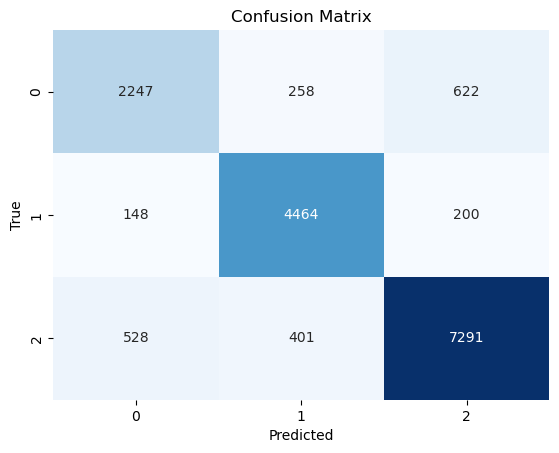

Training and evaluating Random Forest...
Accuracy: 0.8884213132000742
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.66      0.78      3127
           1       0.88      0.94      0.91      4812
           2       0.88      0.94      0.91      8220

    accuracy                           0.89     16159
   macro avg       0.90      0.85      0.87     16159
weighted avg       0.89      0.89      0.88     16159



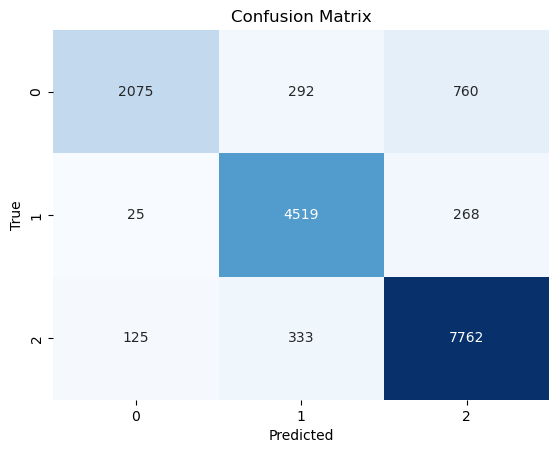

Training and evaluating Support Vector Machine...
Accuracy: 0.9184355467541309
Classification Report:
              precision    recall  f1-score   support

           0       0.92      0.79      0.85      3127
           1       0.89      0.96      0.92      4812
           2       0.94      0.94      0.94      8220

    accuracy                           0.92     16159
   macro avg       0.92      0.90      0.90     16159
weighted avg       0.92      0.92      0.92     16159



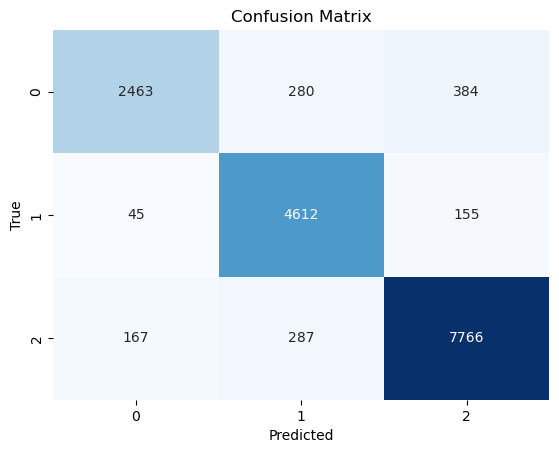

Training and evaluating Naive Bayes...
Accuracy: 0.6234915526950925
Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.18      0.31      3127
           1       0.90      0.28      0.43      4812
           2       0.58      0.99      0.73      8220

    accuracy                           0.62     16159
   macro avg       0.80      0.49      0.49     16159
weighted avg       0.74      0.62      0.56     16159



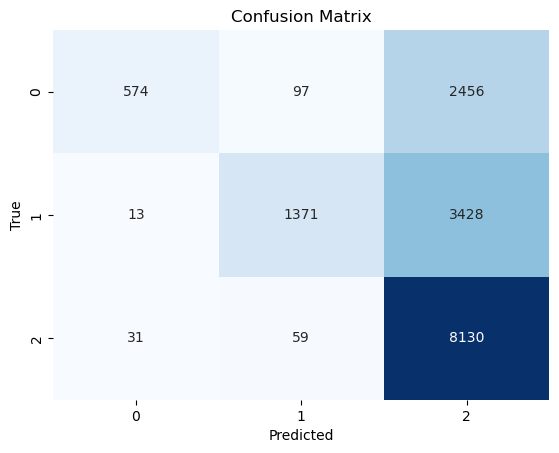

In [76]:
# Initialize models
models = {
    'Decision Tree': DecisionTreeClassifier(),
    'Random Forest': RandomForestClassifier(),
    'Support Vector Machine': SVC(),
    'Naive Bayes': MultinomialNB()
}

# Train and evaluate models
for name, model in models.items():
    print(f"Training and evaluating {name}...")
    train_and_evaluate_model(model, X_train, X_test, y_train, y_test)

<div class="alert alert-block alert-warning">
<b>INSIGHTS:</b>

**Model Performance:**

- The Support Vector Machine (SVM) model achieved the highest accuracy of 91.84%, indicating its effectiveness in classifying sentiment from the given text data.
- Random Forest also performed well with an accuracy of 88.81%, closely following SVM.
- Decision Tree showed slightly lower accuracy compared to Random Forest and SVM, but still achieved a respectable accuracy of 86.91%.
- Naive Bayes, however, demonstrated significantly lower accuracy at 62.35%, indicating that it may not be the best choice for sentiment classification in this context.

**Class-wise Performance:**

- For all models, the 'Neutral' sentiment class had the highest precision, recall, and F1-score. This suggests that the models performed relatively well in identifying neutral sentiments.
- The 'Positive' sentiment class generally had lower precision, recall, and F1-score compared to the 'Neutral' class, especially in the Naive Bayes model.
- The 'Negative' sentiment class showed varying performance across models, with SVM and Random Forest demonstrating relatively higher scores compared to Decision Tree and Naive Bayes.

**Imbalance in Classes:**

- The dataset may suffer from class imbalance, as indicated by the disparities in precision, recall, and F1-score among different sentiment classes.
- The 'Neutral' class appears to be more balanced, with relatively higher precision and recall across models.
- The 'Positive' and 'Negative' classes, on the other hand, exhibit lower precision and recall, particularly in Naive Bayes, indicating challenges in accurately identifying these sentiments.

**Model Selection:**

- Based on the overall performance, SVM and Random Forest emerge as strong candidates for sentiment classification in this context due to their higher accuracy and balanced performance across sentiment classes.
- Decision Tree, while slightly less accurate than SVM and Random Forest, still provides competitive performance and may be a suitable choice depending on specific requirements or constraints.
- Naive Bayes, despite its simplicity, shows suboptimal performance compared to other models and may not be the preferred choice for sentiment classification in this scenario.

**Further Investigation:**

- The results suggest the need for further investigation into improving the classification performance, particularly for the 'Positive' and 'Negative' sentiment classes.
- Strategies such as collecting more labeled data, employing advanced feature engineering techniques, or fine-tuning model hyperparameters could potentially enhance the performance of sentiment classification models.

</div>

In [77]:
df1.to_csv("stock_tweets_sentiments_new.csv", index=False)

## 8. Importing the second Dataset (stock_prices.csv)

In [137]:
df2 = pd.read_csv("stock_prices.csv")

In [138]:
df2.head()

,Date,Open,High,Low,Close,Adj Close,Volume,Stock Name
0,30-09-2021,260.333344,263.043335,258.333344,258.493347,258.493347,53868000,TSLA
1,01-10-2021,259.466675,260.260010,254.529999,258.406677,258.406677,51094200,TSLA
2,04-10-2021,265.500000,268.989990,258.706665,260.510010,260.510010,91449900,TSLA
3,05-10-2021,261.600006,265.769989,258.066681,260.196655,260.196655,55297800,TSLA
4,06-10-2021,258.733337,262.220001,257.739990,260.916656,260.916656,43898400,TSLA


In [139]:
df2.tail()

,Date,Open,High,Low,Close,Adj Close,Volume,Stock Name
6295,23-09-2022,13.09,13.892,12.86,13.71,13.71,28279600,XPEV
6296,26-09-2022,14.28,14.830,14.07,14.37,14.37,27891300,XPEV
6297,27-09-2022,14.58,14.800,13.58,13.71,13.71,21160800,XPEV
6298,28-09-2022,13.05,13.421,12.69,13.33,13.33,31799400,XPEV
6299,29-09-2022,12.55,12.850,11.85,12.11,12.11,33044800,XPEV


### 8.1. Data Exploration

In [140]:
df2.shape

(6300, 8)

In [141]:
df2.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume',
       'Stock Name'],
      dtype='object')

In [142]:
df2.duplicated().sum()

0

In [143]:
df2.isnull().sum()

Date          0
Open          0
High          0
Low           0
Close         0
Adj Close     0
Volume        0
Stock Name    0
dtype: int64

In [144]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6300 entries, 0 to 6299
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Date        6300 non-null   object 
 1   Open        6300 non-null   float64
 2   High        6300 non-null   float64
 3   Low         6300 non-null   float64
 4   Close       6300 non-null   float64
 5   Adj Close   6300 non-null   float64
 6   Volume      6300 non-null   int64  
 7   Stock Name  6300 non-null   object 
dtypes: float64(5), int64(1), object(2)
memory usage: 393.9+ KB


In [145]:
df2.describe()

,Open,High,Low,Close,Adj Close,Volume
count,6300.000000,6300.000000,6300.000000,6300.000000,6300.000000,6.300000e+03
mean,174.748195,177.594589,171.734715,174.657624,173.756012,2.906806e+07
std,134.989675,136.795419,133.049955,134.949601,134.582934,3.342181e+07
min,11.050000,11.210000,10.610000,11.060000,10.837500,3.078000e+05
25%,78.170002,79.891003,76.792501,78.110001,78.110001,5.857700e+06
50%,145.475128,147.475006,143.501251,145.505005,144.248146,1.518830e+07
75%,225.665001,230.662498,221.452496,225.785000,225.785000,4.122928e+07
max,692.349976,700.989990,686.090027,691.690002,691.690002,3.116452e+08


In [146]:
df2.nunique()

Date           252
Open          5673
High          5736
Low           5767
Close         5731
Adj Close     6048
Volume        6245
Stock Name      25
dtype: int64

In [147]:
df2['Stock Name'].unique()

array(['TSLA', 'MSFT', 'PG', 'META', 'AMZN', 'GOOG', 'AMD', 'AAPL',
       'NFLX', 'TSM', 'KO', 'F', 'COST', 'DIS', 'VZ', 'CRM', 'INTC', 'BA',
       'BX', 'NOC', 'PYPL', 'ENPH', 'NIO', 'ZS', 'XPEV'], dtype=object)

In [148]:
df2['Stock Name'].value_counts()

Stock Name
TSLA    252
DIS     252
ZS      252
NIO     252
ENPH    252
PYPL    252
NOC     252
BX      252
BA      252
INTC    252
CRM     252
VZ      252
COST    252
MSFT    252
F       252
KO      252
TSM     252
NFLX    252
AAPL    252
AMD     252
GOOG    252
AMZN    252
META    252
PG      252
XPEV    252
Name: count, dtype: int64

In [149]:
df2_copy = df2.copy()

In [150]:
df2_copy['Date'] = pd.to_datetime(df2['Date'])

In [151]:
df2_copy.set_index('Date', inplace=True)

In [152]:
start_date = df2_copy.index.min()
end_date = df2_copy.index.max()

In [153]:
print("Start Date of Stocks:", start_date)
print("End Date of Stocks:", end_date)

Start Date of Stocks: 2021-09-30 00:00:00
End Date of Stocks: 2022-09-29 00:00:00


## 9. Data Visualization

### 9.1. Line Figure - Stock Prices Over Time

In [154]:
# Create an empty figure
line_fig = go.Figure()

# Iterate over each stock name and its corresponding data
for stock_name, data in df2_copy.groupby('Stock Name'):
    # Add a line trace for the closing price over time
    line_fig.add_trace(go.Scatter(x=data.index, y=data['Close'], mode='lines', name=stock_name))

# Update the layout
line_fig.update_layout(
    title='Stock Price Over Time',
    xaxis_title='Date',
    yaxis_title='Closing Price',
    xaxis_tickangle=-90,
    legend_title='Stock Name'
)

# Show the plot
line_fig.show()

In [155]:
for stock_name, data in df2_copy.groupby('Stock Name'):
    fig = px.line(data, x=data.index, y='Open', title=f'Stock Price Over Time ({stock_name})')
    fig.update_xaxes(title_text='Date', tickangle=-90)
    fig.update_yaxes(title_text='Opening Price')
    fig.show()

### 9.2. Candle Stick - Stock Prices for each Stock

<div class="alert alert-block alert-success">
<b>DO YOU KNOW?:</b>

Candlestick charts are widely used in financial analysis to visualize the price movements of stocks over time, providing insights into the opening, closing, high, and low prices within a specified period. By creating separate candlestick charts for each stock, this code allows for a clear and comparative analysis of price trends and patterns across different companies. The title of each chart includes the name of the corresponding stock, enabling easy identification and interpretation. Additionally, the inclusion of a range slider on the x-axis enhances interactivity, enabling users to zoom in and out on specific time periods for detailed examination of price fluctuations. Overall, these candlestick charts play a crucial role in aiding investors, traders, and analysts in making informed decisions regarding stock investments, portfolio management, and market analysis. </div>

In [156]:
for stock_name, data in df2_copy.groupby('Stock Name'):
    # Create a figure for each stock
    fig = go.Figure(go.Candlestick(
        x=data.index,
        open=data['Open'],
        high=data['High'],
        low=data['Low'],
        close=data['Close'],
        name=stock_name
    ))
    
    # Update the layout for each figure
    fig.update_layout(
        title=f'Candlestick Chart for {stock_name} Stock Prices',
        xaxis_title='Date',
        yaxis_title='Price',
        xaxis_rangeslider_visible=True
    )
    
    # Show the plot
    fig.show()

### 9.3. Bar Plot - Trading Volume Over Time

In [157]:
for stock_name, data in df2_copy.groupby('Stock Name'):
    # Create a figure for each stock
    fig = go.Figure()
    
    # Add a bar trace for the trading volume over time
    fig.add_trace(go.Bar(
        x=data.index,
        y=data['Volume'],
        name='Volume',
        marker_color='blue'
    ))
    
    # Update the layout for each figure
    fig.update_layout(
        title=f'Trading Volume for {stock_name} Over Time',
        xaxis_title='Date',
        yaxis_title='Volume',
        xaxis_rangeslider_visible=True
    )
    
    # Show the plot
    fig.show()

### 9.4. RSI - Individual Stocks

<div class="alert alert-block alert-success">
<b>DO YOU KNOW?:</b>

RSI is a momentum oscillator that measures the speed and change of price movements, indicating whether a stock is overbought or oversold. By looping through each stock's data, calculating RSI using the RSIIndicator function from the ta (technical analysis) library, and adding a line trace for RSI to the plot, this code enables analysts and traders to assess the strength and potential reversal points of price trends for various stocks. Moreover, the addition of horizontal lines representing commonly used overbought (70) and oversold (30) threshold levels enhances the interpretability of the RSI values, providing clear visual cues for potential buying or selling opportunities. Overall, this visualization of RSI helps market participants make more informed trading decisions by identifying potential entry or exit points based on momentum indicators. </div>

In [158]:
# Create an empty figure
fig = go.Figure()

# Loop through each stock name and its corresponding data
for stock_name, data in df2_copy.groupby('Stock Name'):
    # Calculate RSI for each stock
    data['RSI'] = ta.momentum.RSIIndicator(close=data['Close'], window=14).rsi()
    
    # Add a line trace for RSI
    fig.add_trace(go.Scatter(x=data.index, y=data['RSI'], mode='lines', name=f'{stock_name} RSI'))

# Add horizontal lines for overbought and oversold threshold levels
fig.add_hline(y=70, line_dash="dash", line_color="red", annotation_text="Overbought", 
              annotation_position="bottom right")
fig.add_hline(y=30, line_dash="dash", line_color="green", annotation_text="Oversold", 
              annotation_position="top right")

# Update layout
fig.update_layout(title='Relative Strength Index (RSI) for Individual Stocks',
                  xaxis_title='Date',
                  yaxis_title='RSI',
                  legend_title='Stock Name')

fig.show()

### 9.5. Bollinger Bands - For Each Stocks

<div class="alert alert-block alert-success">
<b>DO YOU KNOW?:</b>

Bollinger Bands for individual stocks are widely used in technical analysis to assess price volatility and potential reversal points. Bollinger Bands consist of an upper band, a lower band, and a simple moving average (typically based on the closing price) plotted in between. By looping through each stock's data and calculating Bollinger Bands using the BollingerBands function from the ta (technical analysis) library, this code provides traders and analysts with a graphical representation of price volatility and potential trading opportunities. The upper and lower bands represent the standard deviations of the price from the moving average, offering insights into the stock's price volatility and potential overbought or oversold conditions. Additionally, overlaying the closing price on the same plot allows for easy comparison and identification of price movements relative to the Bollinger Bands. Overall, visualizing Bollinger Bands aids traders in making informed decisions regarding entry and exit points based on price volatility and trend analysis. </div>

In [159]:
for stock_name, data in df2_copy.groupby('Stock Name'):
    # Calculate Bollinger Bands for the current stock
    bb = ta.volatility.BollingerBands(close=data['Close'], window=20, window_dev=2)
    upper_band = bb.bollinger_hband()
    lower_band = bb.bollinger_lband()
    
    # Create a figure for Bollinger Bands of the current stock
    fig = go.Figure()
    
    # Add traces for Bollinger Bands
    fig.add_trace(go.Scatter(x=data.index, y=upper_band, mode='lines', name='Upper Band', line=dict(color='blue')))
    fig.add_trace(go.Scatter(x=data.index, y=lower_band, mode='lines', name='Lower Band', line=dict(color='blue')))

    # Add trace for closing price
    fig.add_trace(go.Scatter(x=data.index, y=data['Close'], mode='lines', name='Closing Price', line=dict(color='black')))
    
    # Update the layout for each figure
    fig.update_layout(
        title=f'Bollinger Bands for {stock_name}',
        xaxis_title='Date',
        yaxis_title='Price',
        xaxis_rangeslider_visible=True,
    )
    
    # Show the plot
    fig.show()

In [160]:
stock_name = 'TSLA'

## 10. Importing the Dataset we got after Sentiment Analysis 

In [161]:
df3 = pd.read_csv('stock_tweets_sentiments_new.csv')

In [162]:
df4 = df3[df3['Stock Name'] == stock_name]

In [163]:
df4.head()

,Date,Tweet,Stock Name,Company Name,Sentiment_Scores,Sentiment,Sentiment_Label
0,2022-09-29 23:41:16+00:00,mainstream medium amazing job brainwash people...,TSLA,"Tesla, Inc.","{'neg': 0.153, 'neu': 0.642, 'pos': 0.205, 'co...",Positive,2
1,2022-09-29 23:24:43+00:00,tesla delivery estimate analyst tsla,TSLA,"Tesla, Inc.","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",Neutral,1
2,2022-09-29 23:18:08+00:00,include unvested rsus additional equity need r...,TSLA,"Tesla, Inc.","{'neg': 0.0, 'neu': 0.896, 'pos': 0.104, 'comp...",Positive,2
3,2022-09-29 22:40:07+00:00,realdanodowd wholemarsblog tesla hahaha try st...,TSLA,"Tesla, Inc.","{'neg': 0.386, 'neu': 0.436, 'pos': 0.178, 'co...",Negative,0
4,2022-09-29 22:27:05+00:00,realdanodowd tesla stop try kill kid sad deran...,TSLA,"Tesla, Inc.","{'neg': 0.588, 'neu': 0.412, 'pos': 0.0, 'comp...",Negative,0


In [164]:
df4.tail()

,Date,Tweet,Stock Name,Company Name,Sentiment_Scores,Sentiment,Sentiment_Label
37417,2021-09-30 02:52:38+00:00,play dirt chasingsunset \n tesla elonmusk tesc...,TSLA,"Tesla, Inc.","{'neg': 0.273, 'neu': 0.455, 'pos': 0.273, 'co...",Neutral,1
37418,2021-09-30 02:40:26+00:00,agree freshjiva tsla ev business worth gt will...,TSLA,"Tesla, Inc.","{'neg': 0.072, 'neu': 0.583, 'pos': 0.344, 'co...",Positive,2
37419,2021-09-30 01:59:02+00:00,hold tight tsla,TSLA,"Tesla, Inc.","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",Neutral,1
37420,2021-09-30 01:38:26+00:00,ready tsla delivery number \n\n ur ans...,TSLA,"Tesla, Inc.","{'neg': 0.0, 'neu': 0.513, 'pos': 0.487, 'comp...",Positive,2
37421,2021-09-30 01:16:13+00:00,word amd give tesla preferential treatment bc ...,TSLA,"Tesla, Inc.","{'neg': 0.0, 'neu': 0.828, 'pos': 0.172, 'comp...",Positive,2


In [165]:
df4.shape

(37422, 7)

In [166]:
df4.columns

Index(['Date', 'Tweet', 'Stock Name', 'Company Name', 'Sentiment_Scores',
       'Sentiment', 'Sentiment_Label'],
      dtype='object')

In [167]:
df4['Date'] = pd.to_datetime(df4['Date'])
df4['Date'] = df4['Date'].dt.date
df4 = df4.drop(columns=['Stock Name', 'Company Name'])

In [168]:
df4 = df4.drop(columns=['Sentiment','Sentiment_Scores'])

In [169]:
df4

,Date,Tweet,Sentiment_Label
0,2022-09-29,mainstream medium amazing job brainwash people...,2
1,2022-09-29,tesla delivery estimate analyst tsla,1
2,2022-09-29,include unvested rsus additional equity need r...,2
3,2022-09-29,realdanodowd wholemarsblog tesla hahaha try st...,0
4,2022-09-29,realdanodowd tesla stop try kill kid sad deran...,0
...,...,...,...
37417,2021-09-30,play dirt chasingsunset \n tesla elonmusk tesc...,1
37418,2021-09-30,agree freshjiva tsla ev business worth gt will...,2
37419,2021-09-30,hold tight tsla,1
37420,2021-09-30,ready tsla delivery number \n\n ur ans...,2


In [170]:
df4['Date'] = pd.to_datetime(df4['Date'])


In [171]:
df4_date = df4.groupby('Date')['Sentiment_Label'].mean()

In [172]:
df4_date = df4_date.to_frame(name='Sentiment_label')

In [173]:
df4_date

,Sentiment_label
Date,
2021-09-30,1.344444
2021-10-01,1.361702
2021-10-02,1.474138
2021-10-03,1.262295
2021-10-04,1.252101
...,...
2022-09-25,1.111111
2022-09-26,1.333333
2022-09-27,1.317647


In [174]:
df6 = df2[df2['Stock Name'] == stock_name]
df6['Date'] = pd.to_datetime(df6['Date'])
df6['Date'] = df6['Date'].dt.date

## 11. Creating Final Dataset After Feature Engineering

In [175]:
df6['Date'] = pd.to_datetime(df6['Date'])

final_df = df6.merge(df4_date, how="left", on="Date")

final_df = final_df.drop(columns=['Stock Name'])


In [176]:
final_df

,Date,Open,High,Low,Close,Adj Close,Volume,Sentiment_label
0,2021-09-30,260.333344,263.043335,258.333344,258.493347,258.493347,53868000,1.344444
1,2021-10-01,259.466675,260.260010,254.529999,258.406677,258.406677,51094200,1.361702
2,2021-10-04,265.500000,268.989990,258.706665,260.510010,260.510010,91449900,1.252101
3,2021-10-05,261.600006,265.769989,258.066681,260.196655,260.196655,55297800,1.181818
4,2021-10-06,258.733337,262.220001,257.739990,260.916656,260.916656,43898400,1.410256
...,...,...,...,...,...,...,...,...
247,2022-09-23,283.089996,284.500000,272.820007,275.329987,275.329987,63748400,1.267442
248,2022-09-26,271.829987,284.089996,270.309998,276.010010,276.010010,58076900,1.333333
249,2022-09-27,283.839996,288.670013,277.510010,282.940002,282.940002,61925200,1.317647
250,2022-09-28,283.079987,289.000000,277.570007,287.809998,287.809998,54664800,1.346667


In [177]:
final_df.shape

(252, 8)

In [178]:
final_df.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume',
       'Sentiment_label'],
      dtype='object')

In [179]:
final_df.duplicated().sum()

0

In [180]:
final_df.isnull().sum()

Date               0
Open               0
High               0
Low                0
Close              0
Adj Close          0
Volume             0
Sentiment_label    0
dtype: int64

In [181]:
fig = px.histogram(final_df, x='Sentiment_label', nbins=20, title='Distribution of Sentiment_Label', labels={'Sentiment_Label': 'Sentiment_label', 'count': 'Frequency'})
fig.show()

In [182]:
mean_value = final_df['Sentiment_label'].mean()
final_df['Sentiment_label'].fillna(mean_value, inplace=True)

In [183]:
final_df.columns

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume',
       'Sentiment_label'],
      dtype='object')

### 11.1. Feature Engineering (Feature Creation)

<div class="alert alert-block alert-info">
<b>PLEASE NOTE:</b>

The features we derived provide valuable insights into price movements, trends, and trading signals. Each derived feature serves a specific purpose: 

1. 'Price Range' calculates the daily range between the high and low prices, offering insights into intraday volatility.
2. 'Price Change' computes the absolute change in closing prices from one day to the next, aiding in tracking daily price movements.
3. 'Moving Averages' (e.g., 20-day and 50-day) smooth out price fluctuations to identify trends and potential reversal points. 
4. 'Price Spread' measures the difference between opening and closing prices, reflecting intraday price movements.
5. 'Price Percentage Change' quantifies the percentage change in closing prices from one day to the next, facilitating the assessment of price dynamics.
6. 'Volume Change' tracks changes in trading volume, indicating shifts in market participation. 
7. 'Bollinger Bands' utilize moving averages and standard deviations to gauge price volatility and potential overbought or oversold conditions 
8. 'MACD' (Moving Average Convergence Divergence) computes the difference between short-term and long-term moving averages, providing insights into bullish or bearish momentum. 

Overall, by adding these derived features, the function enhances the depth and breadth of financial analysis, empowering traders and analysts to make more informed decisions regarding market trends, entry and exit points, and risk management strategies.

In [184]:
def add_derived_features(df):
    # Price Range
    df['Price Range'] = df['High'] - df['Low']

    # Price Change
    df['Price Change'] = df['Close'].diff()

    # Moving Averages (e.g., 20-day and 50-day)
    df['20-day MA'] = df['Close'].rolling(window=20).mean()
    df['50-day MA'] = df['Close'].rolling(window=50).mean()

    # Price Spread
    df['Price Spread'] = df['Open'] - df['Close']

    # Price Percentage Change
    df['Price % Change'] = (df['Close'] - df['Close'].shift(1)) / df['Close'].shift(1) * 100

    # Trading Volume Change
    df['Volume Change'] = df['Volume'] - df['Volume'].shift(1)

    # Bollinger Bands (using a 20-day moving average and 2 standard deviations)
    df['20-day MA'] = df['Close'].rolling(window=20).mean()
    df['Upper Bollinger Band'] = df['20-day MA'] + (df['Close'].rolling(window=20).std() * 2)
    df['Lower Bollinger Band'] = df['20-day MA'] - (df['Close'].rolling(window=20).std() * 2)
    
    # Calculate MACD
    macd = MACD(df['Close'], window_fast=12, window_slow=26, window_sign=9)
    df['MACD'] = macd.macd()
    df['Signal Line'] = macd.macd_signal()

    return df



In [185]:
from ta.trend import macd
final_df = add_derived_features(final_df)

In [186]:
final_df

,Date,Open,High,Low,Close,Adj Close,Volume,Sentiment_label,Price Range,Price Change,20-day MA,50-day MA,Price Spread,Price % Change,Volume Change,Upper Bollinger Band,Lower Bollinger Band,MACD,Signal Line
0,2021-09-30,260.333344,263.043335,258.333344,258.493347,258.493347,53868000,1.344444,4.709992,NaN,NaN,NaN,1.839996,NaN,NaN,NaN,NaN,NaN,NaN
1,2021-10-01,259.466675,260.260010,254.529999,258.406677,258.406677,51094200,1.361702,5.730011,-0.086670,NaN,NaN,1.059998,-0.033529,-2773800.0,NaN,NaN,NaN,NaN
2,2021-10-04,265.500000,268.989990,258.706665,260.510010,260.510010,91449900,1.252101,10.283325,2.103333,NaN,NaN,4.989990,0.813962,40355700.0,NaN,NaN,NaN,NaN
3,2021-10-05,261.600006,265.769989,258.066681,260.196655,260.196655,55297800,1.181818,7.703308,-0.313355,NaN,NaN,1.403351,-0.120285,-36152100.0,NaN,NaN,NaN,NaN
4,2021-10-06,258.733337,262.220001,257.739990,260.916656,260.916656,43898400,1.410256,4.480011,0.720001,NaN,NaN,-2.183319,0.276714,-11399400.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
247,2022-09-23,283.089996,284.500000,272.820007,275.329987,275.329987,63748400,1.267442,11.679993,-13.260010,290.471501,287.259467,7.760010,-4.594757,-6797000.0,316.037384,264.905618,2.326808,4.022835
248,2022-09-26,271.829987,284.089996,270.309998,276.010010,276.010010,58076900,1.333333,13.779999,0.680023,289.867502,287.978334,-4.180023,0.246985,-5671500.0,316.228698,263.506306,0.707316,3.359731
249,2022-09-27,283.839996,288.670013,277.510010,282.940002,282.940002,61925200,1.317647,11.160004,6.929993,289.773502,288.826201,0.899994,2.510776,3848300.0,316.223739,263.323265,-0.016758,2.684433
250,2022-09-28,283.079987,289.000000,277.570007,287.809998,287.809998,54664800,1.346667,11.429993,4.869995,290.279001,289.671801,-4.730011,1.721211,-7260400.0,316.137511,264.420491,-0.195371,2.108472


In [187]:
final_df.columns


Index(['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume',
       'Sentiment_label', 'Price Range', 'Price Change', '20-day MA',
       '50-day MA', 'Price Spread', 'Price % Change', 'Volume Change',
       'Upper Bollinger Band', 'Lower Bollinger Band', 'MACD', 'Signal Line'],
      dtype='object')

In [188]:
final_df['Date'] = pd.to_datetime(final_df['Date'])
final_df.set_index('Date', inplace=True)

## 12. Normalization - MinMaxScaler

<div class="alert alert-block alert-Notes">
<b>PLEASE NOTE:</b>
This normalization process ensures that all features have the same scale, preventing features with larger magnitudes from dominating the model's training process. By using Min-Max scaling, the values of the selected columns are transformed proportionally to fit within the specified range, preserving the relative relationships between data points. This approach is particularly useful when working with machine learning algorithms that are sensitive to the scale of input features, such as gradient-based optimization algorithms (e.g., gradient descent). By applying Min-Max scaling, we ensure that the features contribute equally to the model's learning process, ultimately improving the model's performance and stability. </div>

In [189]:
columns_to_scale = ['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Sentiment_label', 'Price Range',
                     'Price Change', '20-day MA', '50-day MA', 'Price Spread', 'Price % Change',
                     'Volume Change', 'Upper Bollinger Band', 'Lower Bollinger Band']

In [190]:
scaler = MinMaxScaler()
final_df[columns_to_scale] = scaler.fit_transform(final_df[columns_to_scale])

In [191]:
final_df

,Open,High,Low,Close,Adj Close,Volume,Sentiment_label,Price Range,Price Change,20-day MA,50-day MA,Price Spread,Price % Change,Volume Change,Upper Bollinger Band,Lower Bollinger Band,MACD,Signal Line
Date,,,,,,,,,,,,,,,,,,
2021-09-30,0.257387,0.229337,0.258924,0.244819,0.244819,0.122630,0.692518,0.046322,NaN,NaN,NaN,0.422788,NaN,NaN,NaN,NaN,NaN,NaN
2021-10-01,0.253128,0.215174,0.239793,0.244387,0.244387,0.104561,0.719093,0.065928,0.492777,NaN,NaN,0.413446,0.472495,0.359599,NaN,NaN,NaN,NaN
2021-10-04,0.282773,0.259596,0.260802,0.254873,0.254873,0.367441,0.550315,0.153447,0.516039,NaN,NaN,0.460516,0.505451,0.584725,NaN,NaN,NaN,NaN
2021-10-05,0.263610,0.243211,0.257583,0.253311,0.253311,0.131943,0.442085,0.103857,0.490370,NaN,NaN,0.417558,0.469122,0.185372,NaN,NaN,NaN,NaN
2021-10-06,0.249525,0.225147,0.255939,0.256901,0.256901,0.057687,0.793863,0.041902,0.501346,NaN,NaN,0.374601,0.484560,0.314575,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-09-23,0.369202,0.338518,0.331791,0.328758,0.328758,0.186991,0.573939,0.180292,0.352854,0.416582,0.413214,0.493692,0.295125,0.338599,0.344895,0.517760,2.326808,4.022835
2022-09-26,0.313876,0.336432,0.319166,0.332148,0.332148,0.150047,0.675407,0.220656,0.500921,0.412320,0.419187,0.350686,0.483404,0.344473,0.345898,0.507540,0.707316,3.359731
2022-09-27,0.372887,0.359737,0.355381,0.366697,0.366697,0.175115,0.651251,0.170298,0.567306,0.411656,0.426233,0.411530,0.571435,0.394165,0.345872,0.506204,-0.016758,2.684433


In [192]:
# Visualization and analysis
fig = go.Figure()
fig.add_trace(go.Scatter(x=final_df.index, y=final_df['Close'], mode='lines', name='Close Price'))
fig.update_layout(title='Stock Price Over Time', xaxis_title='Date', yaxis_title='Closing Price')
fig.show()

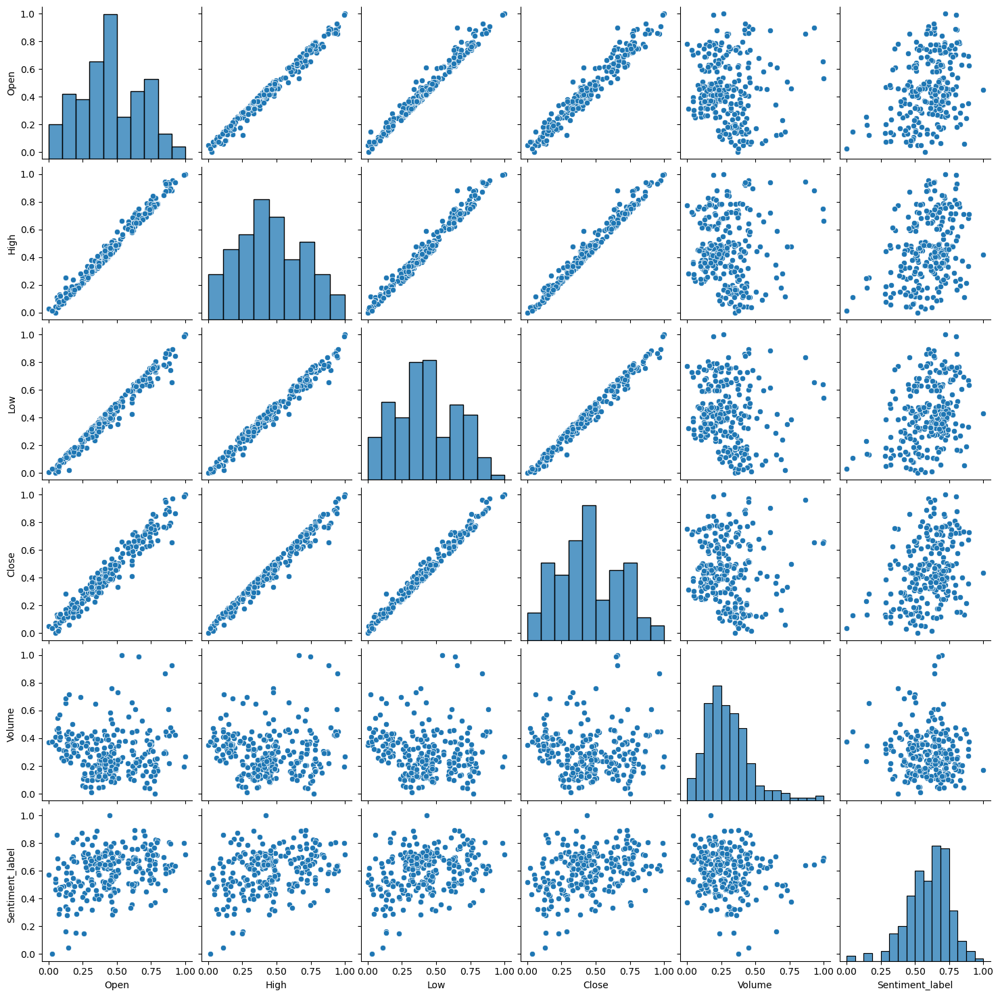

In [193]:
# Pairplot to visualize relationships between numerical features
sns.pairplot(final_df[['Open', 'High', 'Low', 'Close', 'Volume', 'Sentiment_label']])
plt.show()

## 13. Generative Adversarial Network (GAN)

<div class="alert alert-block alert-Notes">
<b>PLEASE NOTE:</b>

It is a powerful framework for generating synthetic data that closely resembles real data distributions. The build_generator function constructs the generator model, which generates fake samples from random noise (latent space) input. 

    - It comprises several fully connected layers with increasing neuron sizes, utilizing ReLU activation functions to introduce non-linearity and Batch Normalization layers to stabilize training. 

    - The output layer uses the hyperbolic tangent activation function (tanh) to ensure that generated samples fall within the desired output range. 

    - The build_discriminator function creates the discriminator model, responsible for distinguishing between real and fake samples. It consists of fully connected layers with decreasing neuron sizes and employs dropout layers to prevent overfitting. 

    - The output layer uses a sigmoid activation function to produce binary classification results indicating the authenticity of input samples. 
    
    - Finally, the build_gan function constructs the GAN model by combining the generator and discriminator networks in a sequential manner, with the discriminator set to non-trainable to prevent it from being updated during GAN training. 
    
This adversarial setup facilitates the training of the generator to produce increasingly realistic fake samples, while the discriminator learns to accurately differentiate between real and fake data, resulting in the generation of high-quality synthetic data distributions.

</div>

In [194]:
latent_dim = 100
output_dim = 1
input_dim = 15
batch_size = 32

In [198]:
from tensorflow.keras import models, layers 
def build_generator(latent_dim, output_dim):
    model = models.Sequential()
    model.add(layers.Dense(256, input_dim=latent_dim, activation='relu'))
    model.add(layers.BatchNormalization())
    model.add(layers.Dense(512, activation='relu'))
    model.add(layers.BatchNormalization())
    model.add(layers.Dense(1024, activation='relu'))
    model.add(layers.BatchNormalization())
    model.add(layers.Dense(output_dim, activation='tanh'))
    return model

def build_discriminator(input_dim):
    model = models.Sequential()
    model.add(layers.Dense(1024, input_dim=input_dim, activation='relu'))
    model.add(layers.Dropout(0.4))
    model.add(layers.Dense(512, activation='relu'))
    model.add(layers.Dropout(0.4))
    model.add(layers.Dense(256, activation='relu'))
    model.add(layers.Dropout(0.4))
    model.add(layers.Dense(1, activation='sigmoid'))
    return model

def build_gan(generator, discriminator):
    discriminator.trainable = False
    model = models.Sequential([generator, discriminator])
    return model


In [199]:
generator = build_generator(latent_dim, output_dim)
discriminator = build_discriminator(output_dim)
gan = build_gan(generator, discriminator)

In [200]:
# Compile Models
discriminator.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
gan.compile(loss='mean_squared_error', optimizer='adam')

In [201]:
# Train GAN
epochs = 50
d_loss_history, g_loss_history = [], []

In [202]:
for epoch in range(epochs):
    for _ in range(len(final_df) // batch_size):
        noise = np.random.normal(0, 1, (batch_size, latent_dim))
        generated_data = generator.predict(noise)
        real_data = final_df.sample(batch_size)['Close'].values

        real_labels = np.ones((batch_size, 1))
        fake_labels = np.zeros((batch_size, 1))

        # Train discriminator
        d_loss_real = discriminator.train_on_batch(real_data, real_labels)
        d_loss_fake = discriminator.train_on_batch(generated_data, fake_labels)
        d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

        # Train generator
        noise = np.random.normal(0, 1, (batch_size, latent_dim))
        g_loss = gan.train_on_batch(noise, real_labels)

    d_loss_history.append(d_loss[0])
    g_loss_history.append(g_loss)
    print(f'Epoch {epoch+1}, D Loss: {d_loss[0]}, G Loss: {g_loss}')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 171ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Epoch 1, D Loss: 0.6950314044952393, G Loss: 0.2428690642118454
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Epoch 2, D Loss: 0.6953779458999634, G Loss: 0.24309317767620087
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Epoch 3, D Loss: 0.6959452629089355, G Loss: 0.2430867701768875
1/1 ━━━━

In [203]:
# Generate Synthetic Data
num_samples = len(final_df)
noise = np.random.normal(0, 1, (num_samples, latent_dim))
generated_data = generator.predict(noise)
generated_df = pd.DataFrame({'Generated_Close': generated_data.reshape(-1)})

1/8 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


In [204]:
generated_df

,Generated_Close
0,-0.999983
1,-1.000000
2,1.000000
3,1.000000
4,-1.000000
...,...
247,-1.000000
248,-1.000000
249,-1.000000
250,1.000000


In [205]:
final_df['Close']

Date
2021-09-30    0.244819
2021-10-01    0.244387
2021-10-04    0.254873
2021-10-05    0.253311
2021-10-06    0.256901
                ...   
2022-09-23    0.328758
2022-09-26    0.332148
2022-09-27    0.366697
2022-09-28    0.390976
2022-09-29    0.293261
Name: Close, Length: 252, dtype: float64

In [206]:
generated_df.reset_index(drop=True, inplace=True)  # Reset index of generated_df
final_df.reset_index(inplace=True)  # Reset index of final_df

# Concatenate final_df and generated_df along the columns axis
final_df = pd.concat([final_df, generated_df], axis=1)


In [207]:
final_df

,Date,Open,High,Low,Close,Adj Close,Volume,Sentiment_label,Price Range,Price Change,20-day MA,50-day MA,Price Spread,Price % Change,Volume Change,Upper Bollinger Band,Lower Bollinger Band,MACD,Signal Line,Generated_Close
0,2021-09-30,0.257387,0.229337,0.258924,0.244819,0.244819,0.122630,0.692518,0.046322,NaN,NaN,NaN,0.422788,NaN,NaN,NaN,NaN,NaN,NaN,-0.999983
1,2021-10-01,0.253128,0.215174,0.239793,0.244387,0.244387,0.104561,0.719093,0.065928,0.492777,NaN,NaN,0.413446,0.472495,0.359599,NaN,NaN,NaN,NaN,-1.000000
2,2021-10-04,0.282773,0.259596,0.260802,0.254873,0.254873,0.367441,0.550315,0.153447,0.516039,NaN,NaN,0.460516,0.505451,0.584725,NaN,NaN,NaN,NaN,1.000000
3,2021-10-05,0.263610,0.243211,0.257583,0.253311,0.253311,0.131943,0.442085,0.103857,0.490370,NaN,NaN,0.417558,0.469122,0.185372,NaN,NaN,NaN,NaN,1.000000
4,2021-10-06,0.249525,0.225147,0.255939,0.256901,0.256901,0.057687,0.793863,0.041902,0.501346,NaN,NaN,0.374601,0.484560,0.314575,NaN,NaN,NaN,NaN,-1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
247,2022-09-23,0.369202,0.338518,0.331791,0.328758,0.328758,0.186991,0.573939,0.180292,0.352854,0.416582,0.413214,0.493692,0.295125,0.338599,0.344895,0.517760,2.326808,4.022835,-1.000000
248,2022-09-26,0.313876,0.336432,0.319166,0.332148,0.332148,0.150047,0.675407,0.220656,0.500921,0.412320,0.419187,0.350686,0.483404,0.344473,0.345898,0.507540,0.707316,3.359731,-1.000000
249,2022-09-27,0.372887,0.359737,0.355381,0.366697,0.366697,0.175115,0.651251,0.170298,0.567306,0.411656,0.426233,0.411530,0.571435,0.394165,0.345872,0.506204,-0.016758,2.684433,-1.000000
250,2022-09-28,0.369153,0.361416,0.355683,0.390976,0.390976,0.127820,0.695940,0.175487,0.545426,0.415223,0.433260,0.344099,0.540731,0.336180,0.345420,0.514217,-0.195371,2.108472,1.000000


<div class="alert alert-block alert-success">
<b>DO YOU KNOW?:</b>

MACD, which stands for Moving Average Convergence Divergence, is a popular technical indicator used in financial analysis to identify changes in momentum, direction, and potential buy or sell signals in a stock or asset. It is calculated by subtracting the longer-term exponential moving average (EMA) from the shorter-term EMA. The MACD line represents the difference between these two EMAs. The Signal Line, often referred to as the MACD Signal or Trigger Line, is a 9-day EMA of the MACD line. 

MACD and the Signal Line provide valuable insights into the strength and direction of price trends. When the MACD line crosses above the Signal Line, it is considered a bullish signal, suggesting a potential uptrend in the stock's price. Conversely, when the MACD line crosses below the Signal Line, it indicates a bearish signal, signaling a potential downtrend. Additionally, the distance between the MACD line and the Signal Line can provide clues about the intensity of the price movement.

By tracking the movements and interactions of the MACD line and the Signal Line over time, traders and analysts can identify potential entry and exit points in the market, confirm trend reversals, and assess the overall momentum of a stock or asset. This information is crucial for making informed trading decisions, implementing effective risk management strategies, and optimizing investment returns. Overall, MACD and the Signal Line are powerful tools that help traders navigate the complexities of financial markets and improve the accuracy of their trading strategies.

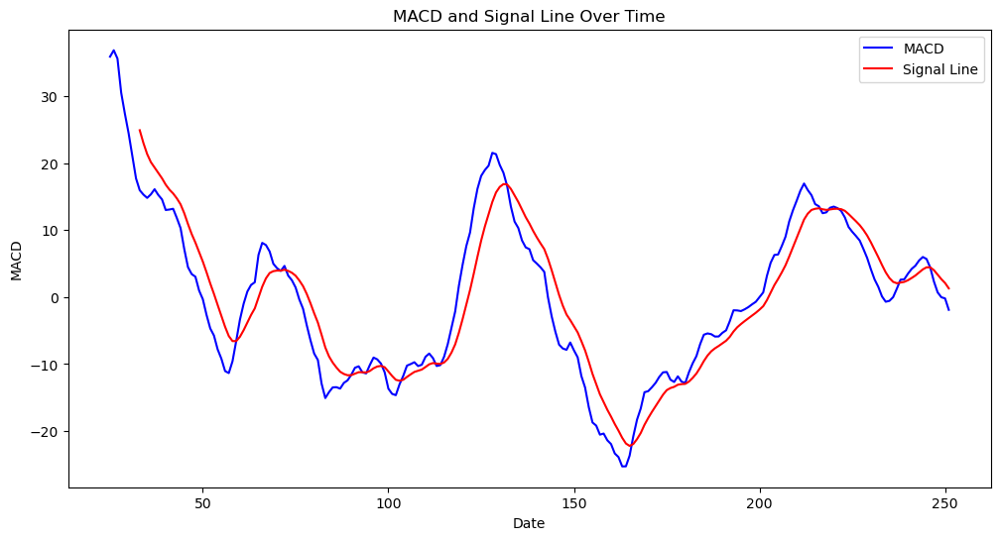

In [208]:
# Visualize MACD
plt.figure(figsize=(12, 6))
plt.plot(final_df.index, final_df['MACD'], label='MACD', color='blue')
plt.plot(final_df.index, final_df['Signal Line'], label='Signal Line', color='red')
plt.title('MACD and Signal Line Over Time')
plt.xlabel('Date')
plt.ylabel('MACD')
plt.legend()
plt.show()

In [209]:
# Visualize Generator and Discriminator Architectures
print("Generator Architecture:")
generator.summary()

Generator Architecture:


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 256)            │        25,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 512)            │       131,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1024)           │       525,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 1024)           │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │         1,025 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 690,945 (2.64 MB)

 Trainable params: 687,361 (2.62 MB)

 Non-trainable params: 3,584 (14.00 KB)

**<u>The generator architecture consists of a sequential model comprising several layers.</u>**
1. The first layer is a dense layer with 256 neurons, which takes input from the latent space and uses the ReLU activation function. 
2. Following this, a batch normalization layer normalizes the activations to stabilize training. The subsequent dense layer contains 512 neurons with ReLU activation, followed by another batch normalization layer. 
3. The architecture then expands further with a dense layer of 1024 neurons and a corresponding batch normalization layer. 
4. Finally, the output layer is a dense layer with a single neuron and a sigmoid activation function, producing the generated output. 

The total number of trainable parameters in the model is 687,361, while the non-trainable parameters, primarily associated with batch normalization layers, are 3,584. This architecture aims to map noise vectors from the latent space to data space, generating synthetic data that closely resembles real data distributions, which is a fundamental aspect of Generative Adversarial Networks (GANs).

In [210]:
print("\nDiscriminator Architecture:")
discriminator.summary()


Discriminator Architecture:


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_4 (Dense)                 │ (None, 1024)           │         2,048 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1024)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 658,433 (2.51 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 658,433 (2.51 MB)

**<u>The discriminator architecture consists of a sequential model with several layers.</u>**
1. It starts with a dense layer containing 1024 neurons, followed by a dropout layer, which randomly drops a fraction of input units to prevent overfitting. 
2. The dropout layer has no trainable parameters. The architecture continues with another dense layer of 512 neurons, followed by another dropout layer. 
3. Subsequently, there is a dense layer with 256 neurons and a corresponding dropout layer. 
4. Finally, the output layer is a dense layer with a single neuron and a sigmoid activation function, which produces binary classification results indicating the authenticity of input samples (real or fake). 

The discriminator has a total of 658,433 parameters, all of which are non-trainable since the discriminator is not updated during GAN training; it only provides feedback to the generator. This architecture enables the discriminator to distinguish between real and fake samples, contributing to the adversarial training process of the Generative Adversarial Network (GAN).

In [214]:
actual_close = final_df['Close']
generated_close = final_df['Generated_Close']

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(actual_close, generated_close)

# Calculate Mean Squared Error (MSE)
mse = mean_squared_error(actual_close, generated_close)

# Calculate Root Mean Squared Error (RMSE)
rmse = np.sqrt(mse)

print(f"Mean Absolute Error (MAE): {mae}")
print(f"Mean Squared Error (MSE): {mse}")
print(f"Root Mean Squared Error (RMSE): {rmse}")

Mean Absolute Error (MAE): 1.240553027355807
Mean Squared Error (MSE): 1.7397210670247076
Root Mean Squared Error (RMSE): 1.3189848623182556


<div class="alert alert-block alert-notes">
<b>NOTE:</b>

MAE represents the average absolute difference between the actual and predicted values, providing a measure of the model's accuracy. MSE measures the average squared difference between the actual and predicted values, emphasizing larger errors due to squaring, and RMSE represents the square root of MSE, giving an interpretable scale similar to the original data. In this case, the calculated MAE is approximately 1.24, MSE is approximately 1.74, and RMSE is approximately 1.32. These metrics help assess the predictive performance of the model and are crucial for understanding its accuracy and reliability in generating closing price predictions.

1. **<u>MAE (Mean Absolute Error):</u>** The MAE value of approximately 1.24 indicates that, on average, the model's predictions deviate from the actual closing prices by about $1.24. MAE provides a straightforward measure of the average magnitude of errors in the predictions.

2. **<u>MSE (Mean Squared Error):</u>** The MSE value of approximately 1.74 represents the average squared difference between the actual and predicted closing prices. Since MSE squares the errors, it gives higher weight to larger errors.

3. **<u>RMSE (Root Mean Squared Error):</u>** The RMSE value of approximately 1.32 is the square root of MSE and provides a measure of the standard deviation of the errors. It is in the same unit as the original data, making it directly interpretable. In this case, an RMSE of approximately 1.32 indicates that, on average, the model's predictions deviate from the actual closing prices by about $1.32.

Overall, these error metrics suggest that the model's performance in predicting closing prices is reasonable, with relatively low errors on average. However, it's essential to consider the context of the specific application and domain expertise to determine whether the obtained error values are acceptable for practical use.







## 14. Conclusion 

In conclusion, this project aimed to develop a predictive model for estimating closing prices in financial markets using sentiment analysis and to check how the sentiments can affect the prices and check how accurate we can predict the close price taking the sentiments related to each stocks into account. The project involved several key steps, 

1. Data Preprocessing and Feature Engineering: This stage involved preparing the data for analysis by cleaning, transforming, and extracting relevant features. Sentiment analysis played a crucial role in understanding the market sentiment associated with each stock, which was then incorporated into the predictive model. Feature engineering also included the creation of additional features such as price range, price change, moving averages, and sentiment-related metrics, which aimed to capture important patterns and trends in the data.

2. Model Training and Evaluation: Various machine learning and deep learning techniques were utilized to build the predictive model, including GANs for synthetic data generation and regression models for price prediction. The model's performance was evaluated using common evaluation metrics such as MAE, MSE, and RMSE, which provide insights into the accuracy and precision of the model's predictions. These metrics serve as benchmarks for assessing the model's effectiveness in estimating closing prices and understanding the impact of sentiment on price movements.

3. Interpretation of Results: The obtained error values, including MAE, MSE, and RMSE, provide quantitative measures of the model's predictive performance. While the results suggest that the model performs reasonably well in estimating closing prices, it's essential to interpret these findings in the context of the specific application and domain. Factors such as the volatility of the financial markets, the reliability of sentiment analysis, and the inherent uncertainties in predicting stock prices should be considered when assessing the model's effectiveness. Additionally, stakeholders may have varying tolerance levels for prediction errors, depending on their investment strategies and risk appetite.



## 15. Future Works

There are multitude of steps that we can take for expanding the scope of this project as well as to better this further.

1. <u><i>Fine-tuning Sentiment Analysis:</u></i> Improve the accuracy of sentiment analysis by incorporating more sophisticated natural language processing (NLP) techniques, such as pre-trained language models (e.g., BERT, GPT) or domain-specific lexicons. Fine-tuning sentiment analysis can lead to better understanding and quantification of market sentiment, thus improving the predictive model's performance.

2. <u><i>Feature Engineering:</u></i> Explore additional features that may influence stock prices, such as macroeconomic indicators, company financial metrics, news sentiment, or social media activity. Incorporating a diverse range of features can provide a more comprehensive understanding of market dynamics and potentially enhance the predictive model's accuracy.

3. <u><i>Model Architecture Optimization:</u></i> Experiment with different model architectures and hyperparameters to improve the predictive model's performance. This could involve exploring advanced neural network architectures, ensemble methods, or reinforcement learning techniques tailored specifically for financial forecasting tasks.

4. <u><i>Ensemble Approaches:</u></i> Implement ensemble learning techniques, such as stacking or blending, to combine the predictions of multiple models. Ensemble methods often lead to improved performance by leveraging the strengths of different models and mitigating individual model biases.

5. <u><i>Dynamic Sentiment Analysis:</u></i> Develop a framework for real-time sentiment analysis that can adapt to changing market conditions and news events. Dynamic sentiment analysis can provide timely insights into market sentiment shifts, allowing for more responsive and accurate predictions of stock prices.

6. <u><i>Interpretability and Explainability:</u></i> Enhance the interpretability of the predictive model by incorporating techniques for model explanation, such as SHAP values or attention mechanisms. This can help stakeholders better understand the factors driving the model's predictions and make more informed decisions.

7. <u><i>Backtesting and Validation:</u></i> Conduct thorough backtesting and validation of the predictive model using historical data to assess its performance under different market conditions. This can help identify potential weaknesses or areas for improvement and ensure the robustness of the model.

8. <u><i>Deployment and Integration:</u></i> Develop a user-friendly interface or application for deploying the predictive model in real-world trading environments. Integration with trading platforms or financial systems can facilitate seamless implementation and adoption by market participants.

By pursuing these future works, the project can be further refined and extended, leading to more accurate and reliable predictions of stock prices and ultimately contributing to more informed decision-making in financial markets.